In [3]:
#%matplotlib notebook
import sys
sys.path.append("/u/yali/script/Plots")
from Plots import plot_static
from plot_static import plot_single
from Plots import plot_animate
from plot_animate import plots
import numpy as np
import matplotlib.pyplot as plt

In [17]:
a = plot_animate.ani_top("gDisk0", 50, 0)
a

In [3]:
b = plot_animate.ani_3d("gDisk6", 45)
b

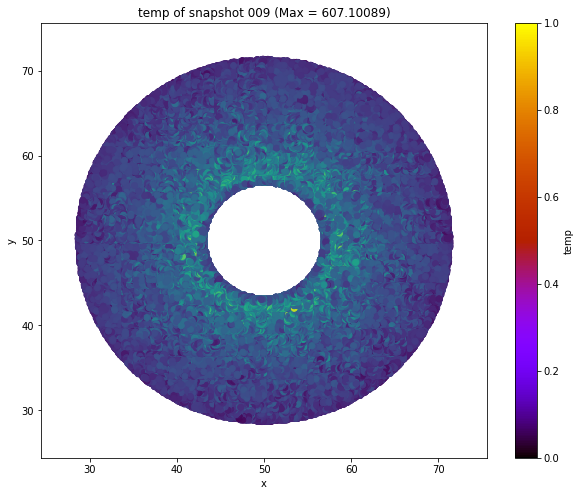

In [7]:
#fig = plt.figure(figsize = (10, 10))
#ax = fig.add_subplot(111, projection='3d')
#ax.view_init(elev=40., azim=40.)
#ax.scatter(a.coordx[a.coordy > 50], a.coordy[a.coordy > 50], a.coordz[a.coordy > 50], s = 0.005)#, c =  a.dens)
#ax.scatter(a.coordx[(a.phi<0.1)&(a.phi>-0.1)], a.coordy[(a.phi<0.1)&(a.phi>-0.1)], a.coordz[(a.phi<0.1)&(a.phi>-0.1)], s = 0.05)
#ax.scatter(a.coordx, a.coordy, a.coordz, s = 0.05)
#plt.scatter(a.coordx[a.coordy > 50], a.coordz[a.coordy > 50], s = 0.8, c = a.dens[a.coordy > 50])
#plt.colorbar()
#plt.xlim(50, 70)
#plt.ylim(49, 69)
a.scatter_qty("xy", "temp")
#a.qty_qty("dens", "specAngMom")

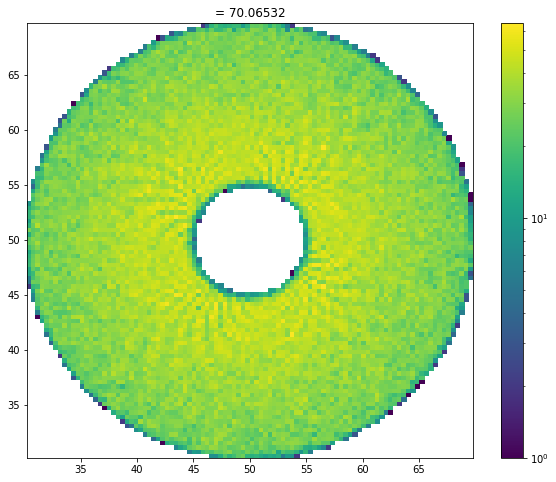

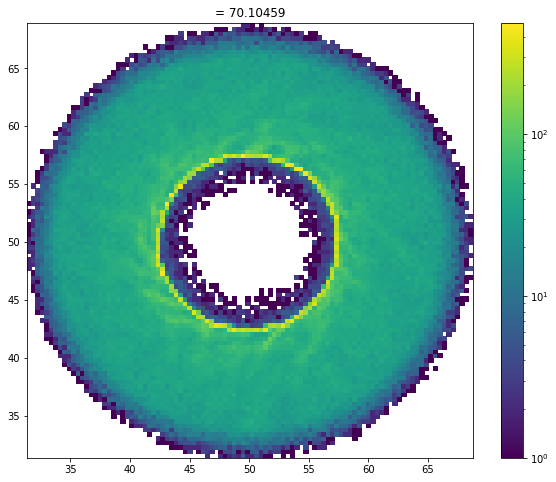

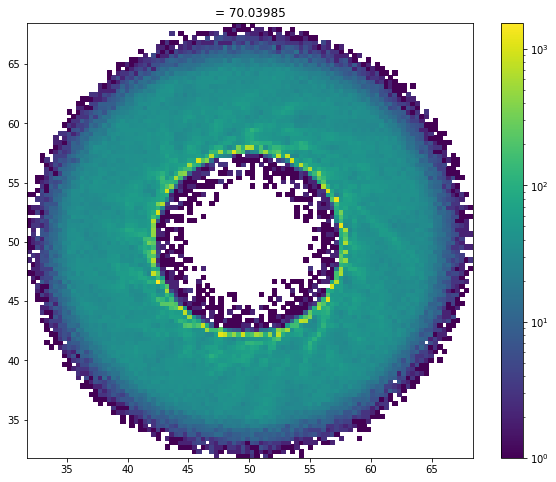

(array([25.80760886, 25.54919003, 25.29345412, ..., 25.05953329,
        25.31458524, 25.57235845]),
 array([0., 0., 0., ..., 0., 0., 0.]))

In [38]:
from matplotlib.colors import LogNorm
import matplotlib.pyplot as plt
import numpy as np
from scipy.stats import gaussian_kde
import matplotlib as mpl
import sys
import h5py
from matplotlib.ticker import MaxNLocator

def draw(i, folder):
    fname = str(format(i, "03d"))
    f = h5py.File("/u/yali/gDisk"+folder+"/test/output/snapshot_"+fname+".hdf5", 'r')
    coord = f['PartType0']['Coordinates'][:,:]
    coordx = coord[:,0]; coordy = coord[:,1]; coordz = coord[:,2]
    vel = f['PartType0']['Velocities'][:,:]
    velx = vel[:,0]; vely = vel[:,1]
    #dens = f['PartType0']['Density'][:]
    rad = ((coordx-50)**2+(coordy-50)**2)**0.5
    #specAngMom = np.sqrt(G*M_star*rad)#velx * (coordx - 50) + vely * (coordy - 50)
    #points.set_data(np.asarray([rad, specAngMom]))
    fig = plt.figure(figsize = (10,8))
    #plt.hist(specAngMom, 20)
    #plt.hist(rad, 20)
    counts,xbins,ybins,image = plt.hist2d(coordx,coordy,bins=100,norm=LogNorm())
    cmap = mpl.cm.gnuplot
    norm1 = mpl.colors.Normalize(vmin=0,vmax=10)
    x = xbins;  y = ybins; z = counts
    x, y = np.meshgrid(x, y)
    dx, dy = 0.05, 0.05
    #plt.pcolormesh(x, y, counts, cmap=cmap, norm=norm1)
    levels = MaxNLocator(nbins=15).tick_values(z.min(), z.max())
    #plt.contourf(x[:-1, :-1] + dx/2., y[:-1, :-1] + dy/2., z, levels=levels, cmap=cmap)
    #plt.imshow(counts)
    r = ((x-50)**2+(y-50)**2)**0.5
    plt.colorbar()
    #plt.legend()
    #levels=np.arange(0,20,20)
    #CSI = plt.contourf(counts.transpose(),extent=[ybins.min(),ybins.max(),xbins.min(),xbins.max()],cmap=cmap,norm=norm1,linewidth=1)
    #plt.contour(counts.transpose(),(30,60,90,120),colors='black',extent=[xbins.min(),xbins.max(),ybins.min(),ybins.max()],linewidths=1,linestyles='solid')
    #ax2 = fig.add_axes([0.92, 0.1, 0.018, 0.75])
    #mpl.colorbar.ColorbarBase(ax2,cmap=cmap, norm=norm1)
    plt.title('= %.5f'%(np.max(f['PartType0']['InternalEnergy'][:])))
    plt.show()
    plt.close()
    return r[:-1, :-1].ravel(), counts.ravel()*0.1/250000/(x[0][1]-x[0][0])**2

def Sigma_init(r):
    res = 0.1/(2*np.pi*(20-5)) * r**(-1)
    res[(r > 20) | (r < 5)] = 0
    return res
radx = np.linspace(0, 26, 200)

#rad1, cou1 = draw(27, "6")
#rad2, cou2 = draw(52, "5")
#plt.figure(figsize = (8, 8))
#plt.scatter(rad1, cou1, c = 'b', label = "cylindical")
#plt.scatter(ra, res, c = 'orange')
#plt.scatter(rad2, cou2, c = 'g', marker = "x", label = "cartesian")
#plt.scatter(ra2, res2, c = 'pink', marker = "x")
#plt.plot(radx, Sigma_init(radx), "black")
#plt.ylim(0, 0.0003)
#plt.legend()

draw(10, "6")
draw(30, "6")
draw(35, "6")

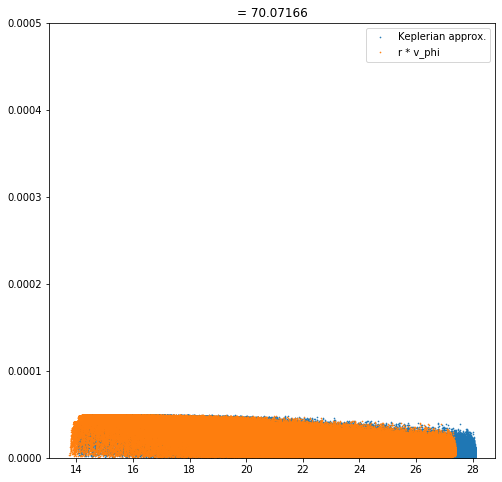

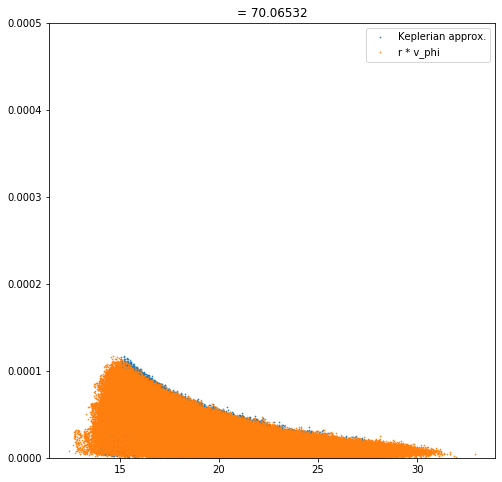

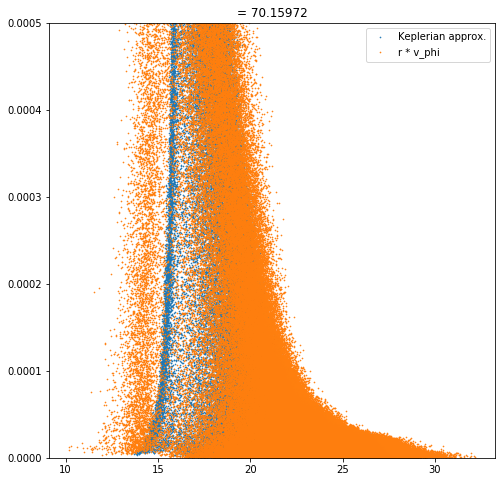

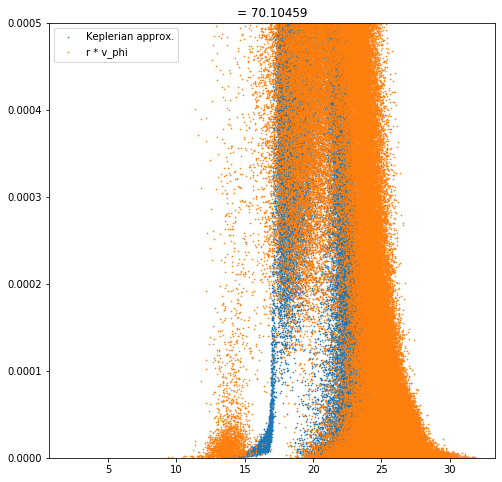

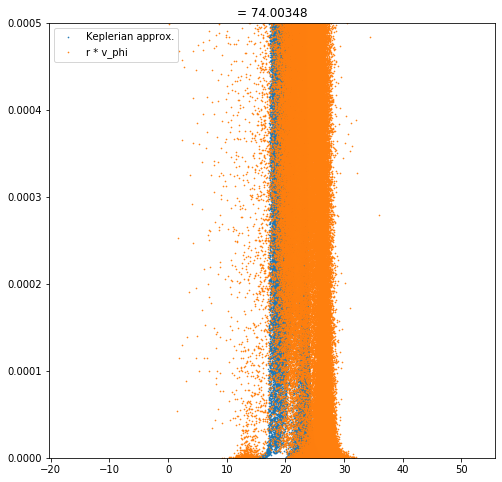

In [34]:
from matplotlib.animation import FuncAnimation
import h5py
import matplotlib.pyplot as plt

G = 39.4429; M_star = 1.0

def draw(i):
    fname = str(format(i, "03d"))
    f = h5py.File("/u/yali/gDisk6/test/output/snapshot_"+fname+".hdf5", 'r')
    coord = f['PartType0']['Coordinates'][:,:]
    coordx = coord[:,0]; coordy = coord[:,1]; coordz = coord[:,2]
    vel = f['PartType0']['Velocities'][:,:]
    velx = vel[:,0]; vely = vel[:,1]
    dens = f['PartType0']['Density'][:]
    rad = ((coordx-50)**2+(coordy-50)**2)**0.5
    specAngMom1 = np.sqrt(G*M_star*rad)
    #specAngMom2 = rad * np.sqrt(velx**2 + vely**2)
    specAngMom3 = ((coordx - 50)*vely - (coordy - 50)*velx)   # v_phi = (x * y\dot - x\dot * y)/r**2 * r, specAngMom = r*v_phi
    #points.set_data(np.asarray([rad, specAngMom]))
    plt.figure(figsize = (8,8))
    #plt.hist(specAngMom, 20)
    #plt.hist(coordz, 200)
    plt.scatter(specAngMom1, dens, label = "Keplerian approx.", s = 0.4)
    #plt.scatter(specAngMom2, dens, label = "test", s = 0.4)
    plt.scatter(specAngMom3, dens, label = "r * v_phi", s = 0.4)
    #plt.yscale("log")
    plt.title('= %.5f'%(np.max(f['PartType0']['InternalEnergy'][:])))
    plt.legend()
    plt.ylim(0, 0.0005)
    plt.show()
    plt.close()

draw(0)
draw(10)
draw(20)
draw(30)
draw(37)
#draw(40)

In [39]:
from matplotlib.animation import FuncAnimation
import h5py
import matplotlib.pyplot as plt


def angmom(folder, frame, start):
    fig = plt.figure(figsize=(10,10))

    def update(i):
        fname = str(format(start + i, "03d"))
        f = h5py.File("/u/yali/"+folder+"/test/output/snapshot_"+fname+".hdf5", 'r')
        coord = f['PartType0']['Coordinates'][:,:]
        vel = f['PartType0']['Velocities'][:,:]
        velx = vel[:,0]; vely = vel[:,1]
        x = coord[:,0]; y = coord[:,1]; r = ((x-50)**2+(y-50)**2)**0.5
        specAngMom = r**0.5 #(r * 39.4429 * 1)**0.5
        dens = f['PartType0']['Density'][:]
        points.set_data(np.asarray([specAngMom, dens]))
        ax.set_title('= %.5f'%(np.max(f['PartType0']['InternalEnergy'][:])))
        return points,

    ax = fig.add_subplot()
    points, = ax.plot([], [], linestyle="", marker='.', markersize = 0.3, alpha=0.8)       
    ax.set_ylim(0, 0.0005);    ax.set_xlim(0, 5)#30)
    plt.xlabel("specific angular momentum");   plt.ylabel("density")
    plt.close()
    ani = FuncAnimation(fig, update, frame, blit=True)    
    return ani

test = angmom("gDisk7", 30, 0)
test

In [ ]:

#from Plots import ytplot
#from Plots import ipvplot
#from ipywebrtc import VideoRecorder

 # optionally, we can record the v ideo
    #rec = MediaRecorder(stream=fig)
    #
    #rec.record = False
    
    # record video
#recorder = VideoRecorder(stream=fig)
#recorder 
    
    #recorder.save()
    #ipv.save('viz-3d-stream.html')
    
    #with open('viz-3d-stream.webm', 'wb') as f:
    #    f.write(rec.data)